In [1]:
%%HTML
<h1 style='color:purple' align='center'>Used Cars Prediction-Mini Project</h1>

In [2]:
import pandas as pd

In [3]:
%%HTML
<h2 style='color:blue'align="center">Data Load: Used Cars data csv into a dataframe</h2>

In [4]:
df=pd.read_csv("Car-Details.csv")

In [5]:
df.shape

(6019, 14)

In [6]:
%%HTML
<h2 style='color:blue' align="center">Data Wrangling</h2>
<h2 style='color:blue' align="center">Data Cleaning: Handle NA values</h2>

In [7]:
df.isnull().sum()

Unnamed: 0              0
Name                    0
Location                0
Year                    0
Kilometers_Driven       0
Fuel_Type               0
Transmission            0
Owner_Type              0
Mileage                 2
Engine                 36
Power                  36
Seats                  42
New_Price            5195
Price                   0
dtype: int64

In [8]:
df.drop(['New_Price'],axis=1,inplace=True)
df.drop(['Unnamed: 0'],axis=1,inplace=True)

In [9]:
df.isnull().sum()

Name                  0
Location              0
Year                  0
Kilometers_Driven     0
Fuel_Type             0
Transmission          0
Owner_Type            0
Mileage               2
Engine               36
Power                36
Seats                42
Price                 0
dtype: int64

In [10]:
print(df.Mileage.value_counts())
print(df.Engine.value_counts())
print(df.Power.value_counts())
print(df.Seats.value_counts())

18.9 kmpl     172
17.0 kmpl     172
18.6 kmpl     119
20.36 kmpl     88
21.1 kmpl      86
             ... 
19.2 km/kg      1
23.01 kmpl      1
14.59 kmpl      1
17.84 kmpl      1
14.47 kmpl      1
Name: Mileage, Length: 442, dtype: int64
1197 CC    606
1248 CC    512
1498 CC    304
998 CC     259
2179 CC    240
          ... 
2147 CC      1
2487 CC      1
1422 CC      1
2112 CC      1
3200 CC      1
Name: Engine, Length: 146, dtype: int64
74 bhp       235
98.6 bhp     131
73.9 bhp     125
140 bhp      123
78.9 bhp     111
            ... 
74.93 bhp      1
500 bhp        1
110.5 bhp      1
261.5 bhp      1
178.4 bhp      1
Name: Power, Length: 372, dtype: int64
5.0     5014
7.0      674
8.0      134
4.0       99
6.0       31
2.0       16
10.0       5
9.0        3
0.0        1
Name: Seats, dtype: int64


In [11]:
df.Mileage=df["Mileage"].fillna("18.9")
df.Engine=df['Engine'].fillna("1197 CC")
df.Power=df['Power'].fillna("74 bhp")
df.Seats=df['Seats'].fillna("5.0")

In [12]:
df.isnull().sum()

Name                 0
Location             0
Year                 0
Kilometers_Driven    0
Fuel_Type            0
Transmission         0
Owner_Type           0
Mileage              0
Engine               0
Power                0
Seats                0
Price                0
dtype: int64

In [13]:
df

,Name,Location,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,Price
0,Maruti Wagon R LXI CNG,Mumbai,2010,72000,CNG,Manual,First,26.6 km/kg,998 CC,58.16 bhp,5,1.75
1,Hyundai Creta 1.6 CRDi SX Option,Pune,2015,41000,Diesel,Manual,First,19.67 kmpl,1582 CC,126.2 bhp,5,12.50
2,Honda Jazz V,Chennai,2011,46000,Petrol,Manual,First,18.2 kmpl,1199 CC,88.7 bhp,5,4.50
3,Maruti Ertiga VDI,Chennai,2012,87000,Diesel,Manual,First,20.77 kmpl,1248 CC,88.76 bhp,7,6.00
4,Audi A4 New 2.0 TDI Multitronic,Coimbatore,2013,40670,Diesel,Automatic,Second,15.2 kmpl,1968 CC,140.8 bhp,5,17.74
...,...,...,...,...,...,...,...,...,...,...,...,...
6014,Maruti Swift VDI,Delhi,2014,27365,Diesel,Manual,First,28.4 kmpl,1248 CC,74 bhp,5,4.75
6015,Hyundai Xcent 1.1 CRDi S,Jaipur,2015,100000,Diesel,Manual,First,24.4 kmpl,1120 CC,71 bhp,5,4.00
6016,Mahindra Xylo D4 BSIV,Jaipur,2012,55000,Diesel,Manual,Second,14.0 kmpl,2498 CC,112 bhp,8,2.90
6017,Maruti Wagon R VXI,Kolkata,2013,46000,Petrol,Manual,First,18.9 kmpl,998 CC,67.1 bhp,5,2.65


In [14]:
for i in df.index:
    df.at[i,'Mileage']=df.at[i,'Mileage'].split()[0]
    df.at[i,'Engine']=df.at[i,'Engine'].split()[0]
    df.at[i,'Power']=df.at[i,'Power'].split()[0]

In [15]:
df.head(5)

,Name,Location,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,Price
0,Maruti Wagon R LXI CNG,Mumbai,2010,72000,CNG,Manual,First,26.6,998,58.16,5,1.75
1,Hyundai Creta 1.6 CRDi SX Option,Pune,2015,41000,Diesel,Manual,First,19.67,1582,126.2,5,12.50
2,Honda Jazz V,Chennai,2011,46000,Petrol,Manual,First,18.2,1199,88.7,5,4.50
3,Maruti Ertiga VDI,Chennai,2012,87000,Diesel,Manual,First,20.77,1248,88.76,7,6.00
4,Audi A4 New 2.0 TDI Multitronic,Coimbatore,2013,40670,Diesel,Automatic,Second,15.2,1968,140.8,5,17.74


In [16]:
%%HTML
<h2 style='color:blue' align="center">...TypeCasting...</h2>

In [17]:
print(df['Mileage'].dtypes)
print(df['Engine'].dtypes)
print(df['Power'].dtypes)
print(df['Seats'].dtypes)
print(df['Price'].dtypes)

object
object
object
object
float64


In [18]:
df['Mileage']=df['Mileage'].astype(float)
df['Engine']=df['Engine'].astype(float)
#df['Power']=df['Power'].astype(float)
df['Seats']=df['Seats'].astype(float)

In [19]:
df['Power'].isnull().sum()

0

In [20]:
for i in df.index:
    if df.Power[i]=='null':
        df.Power[i]=74

<ipython-input-20-95e50eee69c1>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.Power[i]=74


In [21]:
df.Power=df.Power.astype(float)

In [22]:
print(df['Mileage'].dtypes)
print(df['Engine'].dtypes)
print(df['Power'].dtypes)
print(df['Seats'].dtypes)

float64
float64
float64
float64


In [23]:
print(df['Fuel_Type'].unique())
print(df['Transmission'].unique())
print(df['Owner_Type'].unique())
print(df['Location'].unique())
print(df['Name'].unique())

['CNG' 'Diesel' 'Petrol' 'LPG' 'Electric']
['Manual' 'Automatic']
['First' 'Second' 'Fourth & Above' 'Third']
['Mumbai' 'Pune' 'Chennai' 'Coimbatore' 'Hyderabad' 'Jaipur' 'Kochi'
 'Kolkata' 'Delhi' 'Bangalore' 'Ahmedabad']
['Maruti Wagon R LXI CNG' 'Hyundai Creta 1.6 CRDi SX Option'
 'Honda Jazz V' ... 'Volkswagen Polo IPL II 1.2 Petrol Highline'
 'Tata Bolt Revotron XT' 'Mahindra Xylo D4 BSIV']


In [24]:
%%HTML 
<h2 style='color:blue'align='center'>Use CounterPlot to Visualize the Uniqueness</h2>

C:\Users\ksara\AppData\Local\Programs\Python\Python38-32\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Fuel_Type', ylabel='count'>

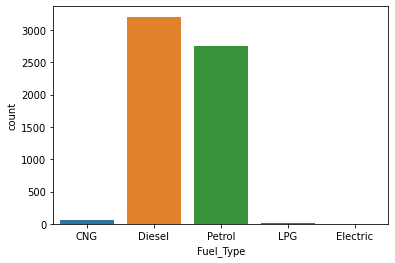

In [25]:
import seaborn as sns
sns.countplot('Fuel_Type',data=df)

C:\Users\ksara\AppData\Local\Programs\Python\Python38-32\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Transmission', ylabel='count'>

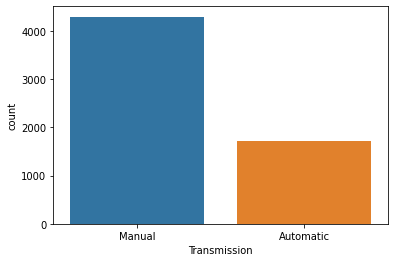

In [26]:
sns.countplot('Transmission',data=df)

C:\Users\ksara\AppData\Local\Programs\Python\Python38-32\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Owner_Type', ylabel='count'>

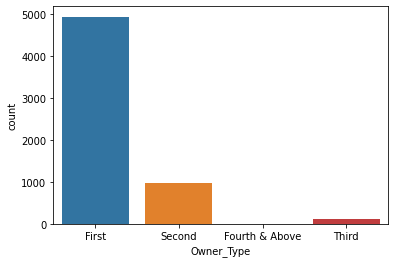

In [27]:
sns.countplot('Owner_Type',data=df)

C:\Users\ksara\AppData\Local\Programs\Python\Python38-32\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Location', ylabel='count'>

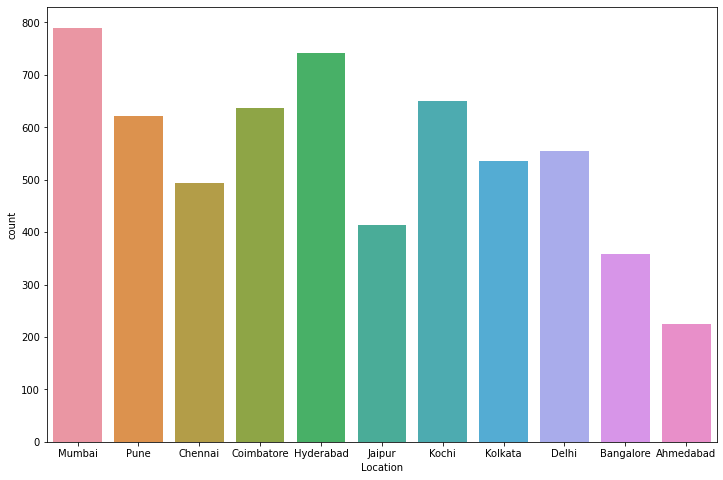

In [28]:
import matplotlib.pyplot as plt
plt.figure(figsize = (12,8))
sns.countplot('Location',data=df)

In [29]:
print(df.Name.value_counts())

Mahindra XUV500 W8 2WD           49
Maruti Swift VDI                 45
Maruti Swift Dzire VDI           34
Honda City 1.5 S MT              34
Maruti Swift VDI BSIV            31
                                 ..
Mahindra Xylo D4 BSIV             1
Ford Fiesta Titanium 1.5 TDCi     1
Maruti Swift ZXI ABS              1
Mahindra Bolero SLE BSIII         1
Nissan Sunny XE P                 1
Name: Name, Length: 1876, dtype: int64


In [30]:
for i in df.index:
    df.at[i,'Name']=df.loc[i,'Name'].split()[0]

In [31]:
print(df.Name.value_counts())

Maruti           1211
Hyundai          1107
Honda             608
Toyota            411
Mercedes-Benz     318
Volkswagen        315
Ford              300
Mahindra          272
BMW               267
Audi              236
Tata              186
Skoda             173
Renault           145
Chevrolet         121
Nissan             91
Land               60
Jaguar             40
Fiat               28
Mitsubishi         27
Mini               26
Volvo              21
Porsche            18
Jeep               15
Datsun             13
Force               3
ISUZU               2
Isuzu               1
Smart               1
Ambassador          1
Lamborghini         1
Bentley             1
Name: Name, dtype: int64


In [32]:
print(df['Name'].unique())

['Maruti' 'Hyundai' 'Honda' 'Audi' 'Nissan' 'Toyota' 'Volkswagen' 'Tata'
 'Land' 'Mitsubishi' 'Renault' 'Mercedes-Benz' 'BMW' 'Mahindra' 'Ford'
 'Porsche' 'Datsun' 'Jaguar' 'Volvo' 'Chevrolet' 'Skoda' 'Mini' 'Fiat'
 'Jeep' 'Smart' 'Ambassador' 'Isuzu' 'ISUZU' 'Force' 'Bentley'
 'Lamborghini']


C:\Users\ksara\AppData\Local\Programs\Python\Python38-32\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Name', ylabel='count'>

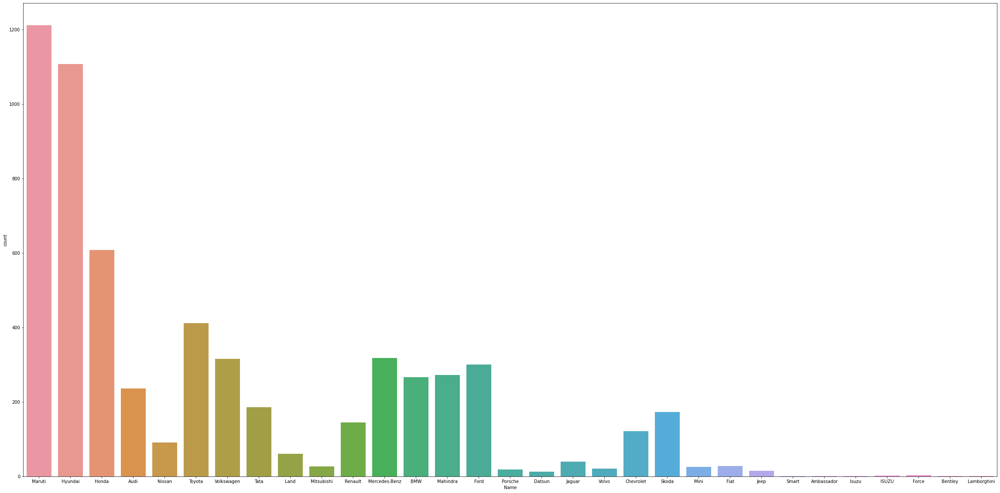

In [33]:
plt.figure(figsize = (40,20))
sns.countplot('Name',data=df)

In [34]:
%%HTML 
<h2 style='color:blue'align='center'>Use Hot Encoding For Location,Name,Transmission,Fuel_Type,Owner_Type</h2>

In [35]:
dumies=pd.get_dummies(df.Transmission)

In [36]:
dumies

,Automatic,Manual
0,0,1
1,0,1
2,0,1
3,0,1
4,1,0
...,...,...
6014,0,1
6015,0,1
6016,0,1
6017,0,1


In [37]:
df=pd.concat([df,dumies],axis=1)

In [38]:
df

,Name,Location,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,Price,Automatic,Manual
0,Maruti,Mumbai,2010,72000,CNG,Manual,First,26.60,998.0,58.16,5.0,1.75,0,1
1,Hyundai,Pune,2015,41000,Diesel,Manual,First,19.67,1582.0,126.20,5.0,12.50,0,1
2,Honda,Chennai,2011,46000,Petrol,Manual,First,18.20,1199.0,88.70,5.0,4.50,0,1
3,Maruti,Chennai,2012,87000,Diesel,Manual,First,20.77,1248.0,88.76,7.0,6.00,0,1
4,Audi,Coimbatore,2013,40670,Diesel,Automatic,Second,15.20,1968.0,140.80,5.0,17.74,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6014,Maruti,Delhi,2014,27365,Diesel,Manual,First,28.40,1248.0,74.00,5.0,4.75,0,1
6015,Hyundai,Jaipur,2015,100000,Diesel,Manual,First,24.40,1120.0,71.00,5.0,4.00,0,1
6016,Mahindra,Jaipur,2012,55000,Diesel,Manual,Second,14.00,2498.0,112.00,8.0,2.90,0,1
6017,Maruti,Kolkata,2013,46000,Petrol,Manual,First,18.90,998.0,67.10,5.0,2.65,0,1


In [39]:
dumies=pd.get_dummies(df.Owner_Type)

In [40]:
df=pd.concat([df,dumies],axis=1)

In [41]:
df

,Name,Location,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,Price,Automatic,Manual,First,Fourth & Above,Second,Third
0,Maruti,Mumbai,2010,72000,CNG,Manual,First,26.60,998.0,58.16,5.0,1.75,0,1,1,0,0,0
1,Hyundai,Pune,2015,41000,Diesel,Manual,First,19.67,1582.0,126.20,5.0,12.50,0,1,1,0,0,0
2,Honda,Chennai,2011,46000,Petrol,Manual,First,18.20,1199.0,88.70,5.0,4.50,0,1,1,0,0,0
3,Maruti,Chennai,2012,87000,Diesel,Manual,First,20.77,1248.0,88.76,7.0,6.00,0,1,1,0,0,0
4,Audi,Coimbatore,2013,40670,Diesel,Automatic,Second,15.20,1968.0,140.80,5.0,17.74,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6014,Maruti,Delhi,2014,27365,Diesel,Manual,First,28.40,1248.0,74.00,5.0,4.75,0,1,1,0,0,0
6015,Hyundai,Jaipur,2015,100000,Diesel,Manual,First,24.40,1120.0,71.00,5.0,4.00,0,1,1,0,0,0
6016,Mahindra,Jaipur,2012,55000,Diesel,Manual,Second,14.00,2498.0,112.00,8.0,2.90,0,1,0,0,1,0
6017,Maruti,Kolkata,2013,46000,Petrol,Manual,First,18.90,998.0,67.10,5.0,2.65,0,1,1,0,0,0


In [42]:
dumies=pd.get_dummies(df.Fuel_Type)

In [43]:
df=pd.concat([df,dumies],axis=1)

In [44]:
df

,Name,Location,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,...,Manual,First,Fourth & Above,Second,Third,CNG,Diesel,Electric,LPG,Petrol
0,Maruti,Mumbai,2010,72000,CNG,Manual,First,26.60,998.0,58.16,...,1,1,0,0,0,1,0,0,0,0
1,Hyundai,Pune,2015,41000,Diesel,Manual,First,19.67,1582.0,126.20,...,1,1,0,0,0,0,1,0,0,0
2,Honda,Chennai,2011,46000,Petrol,Manual,First,18.20,1199.0,88.70,...,1,1,0,0,0,0,0,0,0,1
3,Maruti,Chennai,2012,87000,Diesel,Manual,First,20.77,1248.0,88.76,...,1,1,0,0,0,0,1,0,0,0
4,Audi,Coimbatore,2013,40670,Diesel,Automatic,Second,15.20,1968.0,140.80,...,0,0,0,1,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6014,Maruti,Delhi,2014,27365,Diesel,Manual,First,28.40,1248.0,74.00,...,1,1,0,0,0,0,1,0,0,0
6015,Hyundai,Jaipur,2015,100000,Diesel,Manual,First,24.40,1120.0,71.00,...,1,1,0,0,0,0,1,0,0,0
6016,Mahindra,Jaipur,2012,55000,Diesel,Manual,Second,14.00,2498.0,112.00,...,1,0,0,1,0,0,1,0,0,0
6017,Maruti,Kolkata,2013,46000,Petrol,Manual,First,18.90,998.0,67.10,...,1,1,0,0,0,0,0,0,0,1


In [45]:
df.drop(['Transmission','Owner_Type','Fuel_Type'],axis=1,inplace=True)

In [46]:
df

,Name,Location,Year,Kilometers_Driven,Mileage,Engine,Power,Seats,Price,Automatic,Manual,First,Fourth & Above,Second,Third,CNG,Diesel,Electric,LPG,Petrol
0,Maruti,Mumbai,2010,72000,26.60,998.0,58.16,5.0,1.75,0,1,1,0,0,0,1,0,0,0,0
1,Hyundai,Pune,2015,41000,19.67,1582.0,126.20,5.0,12.50,0,1,1,0,0,0,0,1,0,0,0
2,Honda,Chennai,2011,46000,18.20,1199.0,88.70,5.0,4.50,0,1,1,0,0,0,0,0,0,0,1
3,Maruti,Chennai,2012,87000,20.77,1248.0,88.76,7.0,6.00,0,1,1,0,0,0,0,1,0,0,0
4,Audi,Coimbatore,2013,40670,15.20,1968.0,140.80,5.0,17.74,1,0,0,0,1,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6014,Maruti,Delhi,2014,27365,28.40,1248.0,74.00,5.0,4.75,0,1,1,0,0,0,0,1,0,0,0
6015,Hyundai,Jaipur,2015,100000,24.40,1120.0,71.00,5.0,4.00,0,1,1,0,0,0,0,1,0,0,0
6016,Mahindra,Jaipur,2012,55000,14.00,2498.0,112.00,8.0,2.90,0,1,0,0,1,0,0,1,0,0,0
6017,Maruti,Kolkata,2013,46000,18.90,998.0,67.10,5.0,2.65,0,1,1,0,0,0,0,0,0,0,1


In [47]:
dumies=pd.get_dummies(df.Location)

In [48]:
df=pd.concat([df,dumies],axis=1)

In [49]:
df


,Name,Location,Year,Kilometers_Driven,Mileage,Engine,Power,Seats,Price,Automatic,...,Bangalore,Chennai,Coimbatore,Delhi,Hyderabad,Jaipur,Kochi,Kolkata,Mumbai,Pune
0,Maruti,Mumbai,2010,72000,26.60,998.0,58.16,5.0,1.75,0,...,0,0,0,0,0,0,0,0,1,0
1,Hyundai,Pune,2015,41000,19.67,1582.0,126.20,5.0,12.50,0,...,0,0,0,0,0,0,0,0,0,1
2,Honda,Chennai,2011,46000,18.20,1199.0,88.70,5.0,4.50,0,...,0,1,0,0,0,0,0,0,0,0
3,Maruti,Chennai,2012,87000,20.77,1248.0,88.76,7.0,6.00,0,...,0,1,0,0,0,0,0,0,0,0
4,Audi,Coimbatore,2013,40670,15.20,1968.0,140.80,5.0,17.74,1,...,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6014,Maruti,Delhi,2014,27365,28.40,1248.0,74.00,5.0,4.75,0,...,0,0,0,1,0,0,0,0,0,0
6015,Hyundai,Jaipur,2015,100000,24.40,1120.0,71.00,5.0,4.00,0,...,0,0,0,0,0,1,0,0,0,0
6016,Mahindra,Jaipur,2012,55000,14.00,2498.0,112.00,8.0,2.90,0,...,0,0,0,0,0,1,0,0,0,0
6017,Maruti,Kolkata,2013,46000,18.90,998.0,67.10,5.0,2.65,0,...,0,0,0,0,0,0,0,1,0,0


In [50]:
df.drop(['Location'],axis=1,inplace=True)

In [51]:
df

,Name,Year,Kilometers_Driven,Mileage,Engine,Power,Seats,Price,Automatic,Manual,...,Bangalore,Chennai,Coimbatore,Delhi,Hyderabad,Jaipur,Kochi,Kolkata,Mumbai,Pune
0,Maruti,2010,72000,26.60,998.0,58.16,5.0,1.75,0,1,...,0,0,0,0,0,0,0,0,1,0
1,Hyundai,2015,41000,19.67,1582.0,126.20,5.0,12.50,0,1,...,0,0,0,0,0,0,0,0,0,1
2,Honda,2011,46000,18.20,1199.0,88.70,5.0,4.50,0,1,...,0,1,0,0,0,0,0,0,0,0
3,Maruti,2012,87000,20.77,1248.0,88.76,7.0,6.00,0,1,...,0,1,0,0,0,0,0,0,0,0
4,Audi,2013,40670,15.20,1968.0,140.80,5.0,17.74,1,0,...,0,0,1,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6014,Maruti,2014,27365,28.40,1248.0,74.00,5.0,4.75,0,1,...,0,0,0,1,0,0,0,0,0,0
6015,Hyundai,2015,100000,24.40,1120.0,71.00,5.0,4.00,0,1,...,0,0,0,0,0,1,0,0,0,0
6016,Mahindra,2012,55000,14.00,2498.0,112.00,8.0,2.90,0,1,...,0,0,0,0,0,1,0,0,0,0
6017,Maruti,2013,46000,18.90,998.0,67.10,5.0,2.65,0,1,...,0,0,0,0,0,0,0,1,0,0


In [52]:
dumies=pd.get_dummies(df.Name)
dumies

,Ambassador,Audi,BMW,Bentley,Chevrolet,Datsun,Fiat,Force,Ford,Honda,...,Mitsubishi,Nissan,Porsche,Renault,Skoda,Smart,Tata,Toyota,Volkswagen,Volvo
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6014,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6015,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6016,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6017,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [53]:
df=pd.concat([df,dumies],axis=1)
df

,Name,Year,Kilometers_Driven,Mileage,Engine,Power,Seats,Price,Automatic,Manual,...,Mitsubishi,Nissan,Porsche,Renault,Skoda,Smart,Tata,Toyota,Volkswagen,Volvo
0,Maruti,2010,72000,26.60,998.0,58.16,5.0,1.75,0,1,...,0,0,0,0,0,0,0,0,0,0
1,Hyundai,2015,41000,19.67,1582.0,126.20,5.0,12.50,0,1,...,0,0,0,0,0,0,0,0,0,0
2,Honda,2011,46000,18.20,1199.0,88.70,5.0,4.50,0,1,...,0,0,0,0,0,0,0,0,0,0
3,Maruti,2012,87000,20.77,1248.0,88.76,7.0,6.00,0,1,...,0,0,0,0,0,0,0,0,0,0
4,Audi,2013,40670,15.20,1968.0,140.80,5.0,17.74,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6014,Maruti,2014,27365,28.40,1248.0,74.00,5.0,4.75,0,1,...,0,0,0,0,0,0,0,0,0,0
6015,Hyundai,2015,100000,24.40,1120.0,71.00,5.0,4.00,0,1,...,0,0,0,0,0,0,0,0,0,0
6016,Mahindra,2012,55000,14.00,2498.0,112.00,8.0,2.90,0,1,...,0,0,0,0,0,0,0,0,0,0
6017,Maruti,2013,46000,18.90,998.0,67.10,5.0,2.65,0,1,...,0,0,0,0,0,0,0,0,0,0


In [54]:
df.drop(['Name'],axis=1,inplace=True)
df

,Year,Kilometers_Driven,Mileage,Engine,Power,Seats,Price,Automatic,Manual,First,...,Mitsubishi,Nissan,Porsche,Renault,Skoda,Smart,Tata,Toyota,Volkswagen,Volvo
0,2010,72000,26.60,998.0,58.16,5.0,1.75,0,1,1,...,0,0,0,0,0,0,0,0,0,0
1,2015,41000,19.67,1582.0,126.20,5.0,12.50,0,1,1,...,0,0,0,0,0,0,0,0,0,0
2,2011,46000,18.20,1199.0,88.70,5.0,4.50,0,1,1,...,0,0,0,0,0,0,0,0,0,0
3,2012,87000,20.77,1248.0,88.76,7.0,6.00,0,1,1,...,0,0,0,0,0,0,0,0,0,0
4,2013,40670,15.20,1968.0,140.80,5.0,17.74,1,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6014,2014,27365,28.40,1248.0,74.00,5.0,4.75,0,1,1,...,0,0,0,0,0,0,0,0,0,0
6015,2015,100000,24.40,1120.0,71.00,5.0,4.00,0,1,1,...,0,0,0,0,0,0,0,0,0,0
6016,2012,55000,14.00,2498.0,112.00,8.0,2.90,0,1,0,...,0,0,0,0,0,0,0,0,0,0
6017,2013,46000,18.90,998.0,67.10,5.0,2.65,0,1,1,...,0,0,0,0,0,0,0,0,0,0


In [55]:
import seaborn as sns

In [56]:
%%HTML
<h2 style='color:blue' align="center">Find Corelation</h2>

In [57]:
df1=df[['Year','Kilometers_Driven','Mileage','Engine','Power','Seats','Price']]
df.corr()

,Year,Kilometers_Driven,Mileage,Engine,Power,Seats,Price,Automatic,Manual,First,...,Mitsubishi,Nissan,Porsche,Renault,Skoda,Smart,Tata,Toyota,Volkswagen,Volvo
Year,1.000000,-0.173048,0.321535,-0.046288,0.039699,0.015204,0.305327,0.097059,-0.097059,0.373494,...,-0.046136,-0.006495,-0.002278,0.071937,-0.053214,-0.021126,0.004221,-0.029055,0.010991,-0.001312
Kilometers_Driven,-0.173048,1.000000,-0.065260,0.090476,0.029932,0.082782,-0.011493,-0.025663,0.025663,-0.078563,...,0.017294,0.009056,-0.011217,-0.010070,0.018418,0.006252,0.016779,0.073876,-0.003969,0.007652
Mileage,0.321535,-0.065260,1.000000,-0.581362,-0.482010,-0.299649,-0.306570,-0.333007,0.333007,0.151495,...,-0.088270,0.033172,-0.055228,0.088125,-0.050835,-0.051029,0.066441,-0.221236,0.006344,-0.034123
Engine,-0.046288,0.090476,-0.581362,1.000000,0.860401,0.393849,0.657196,0.498935,-0.498935,-0.046806,...,0.102686,-0.032447,0.169753,-0.080704,0.048036,-0.017600,-0.080228,0.311151,-0.069113,0.053366
Power,0.039699,0.029932,-0.482010,0.860401,1.000000,0.105539,0.770415,0.641545,-0.641545,-0.019855,...,0.034859,-0.056130,0.194668,-0.073320,0.045325,-0.009223,-0.109403,0.073099,-0.077722,0.082921
Seats,0.015204,0.082782,-0.299649,0.393849,0.105539,1.000000,0.052811,-0.074838,0.074838,-0.002300,...,0.066378,-0.039156,-0.082954,-0.045873,-0.059055,-0.052389,-0.022008,0.410299,-0.083449,-0.006334
Price,0.305327,-0.011493,-0.306570,0.657196,0.770415,0.052811,1.000000,0.586025,-0.586025,0.091808,...,0.009477,-0.052509,0.190289,-0.051690,-0.029530,-0.007466,-0.094443,0.050832,-0.087643,0.049314
Automatic,0.097059,-0.025663,-0.333007,0.498935,0.641545,-0.074838,0.586025,1.000000,-1.000000,0.000459,...,-0.009441,-0.042205,0.079850,-0.056208,0.095884,0.020379,-0.089575,-0.026897,-0.051216,0.087309
Manual,-0.097059,0.025663,0.333007,-0.498935,-0.641545,0.074838,-0.586025,-1.000000,1.000000,-0.000459,...,0.009441,0.042205,-0.079850,0.056208,-0.095884,-0.020379,0.089575,0.026897,0.051216,-0.087309
First,0.373494,-0.078563,0.151495,-0.046806,-0.019855,-0.002300,0.091808,0.000459,-0.000459,1.000000,...,-0.020081,0.001695,-0.013750,0.023237,0.008596,-0.027412,-0.035692,-0.011239,0.017521,-0.008758


In [58]:
%%HTML
<h2 style='color:blue' align="center">Visualized Corelation</h2>

<AxesSubplot:>

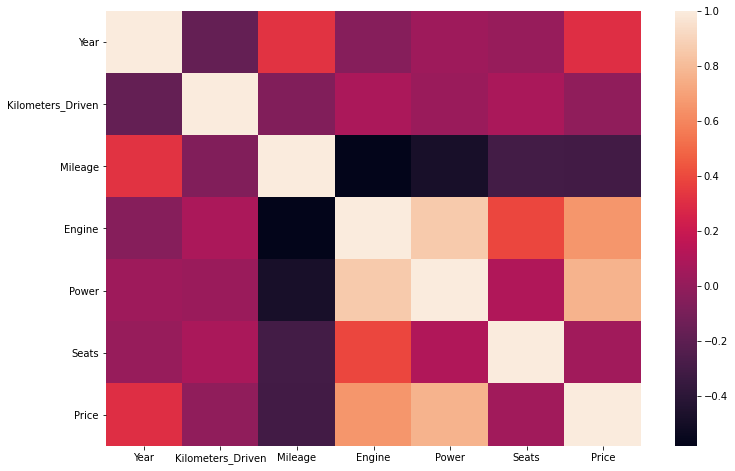

In [59]:
plt.figure(figsize = (12,8))
sns.heatmap(df1.corr())

In [60]:
%%HTML
<h2 style='color:blue' align="center">Visualized the data using pairwise plot</h2>

<Figure size 864x576 with 0 Axes>

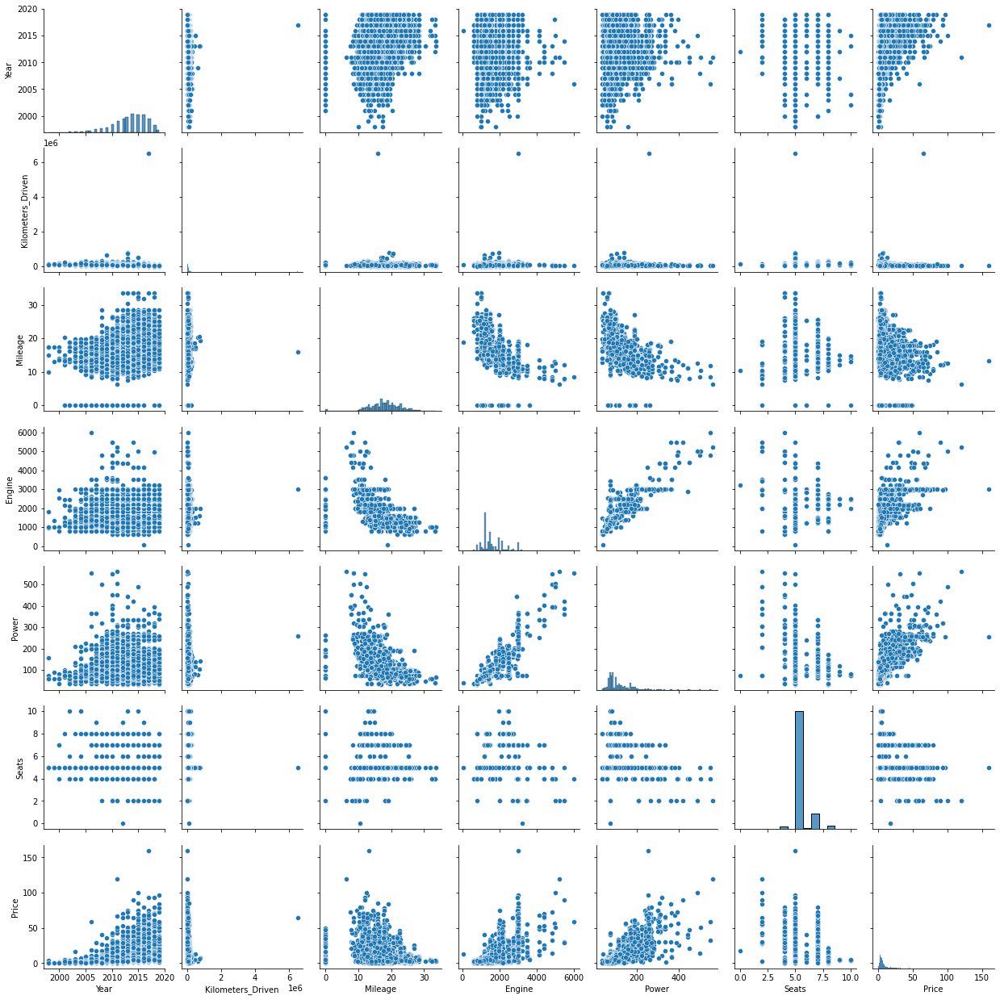

In [61]:
plt.figure(figsize = (12,8))
sns.pairplot(df1)

In [62]:
%%HTML
<h2 style='color:blue'align='center'>Build a Model Now...</h2>

In [63]:
x=df.drop(['Price'],axis=1)

In [64]:
y=df.Price

In [65]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)

In [66]:
from sklearn import linear_model
from sklearn.metrics import r2_score
reg=linear_model.LinearRegression()

In [67]:
reg.fit(X_train,y_train)

LinearRegression()

In [68]:
reg.score(X_test,y_test)

0.7615225684566715

In [69]:
from sklearn.ensemble import RandomForestRegressor
regressor=RandomForestRegressor(n_estimators=10)

In [70]:
regressor.fit(X_train,y_train)

RandomForestRegressor(n_estimators=10)

In [71]:
regressor.score(X_test,y_test)

0.8605626116557519

In [72]:
%%HTML
<h2 style='color:blue'align='center'>Use R^2 to measure accuracy of our models</h2>

In [73]:
r2_score(reg.predict(X_train), y_train)

0.7165262385871631

In [74]:
r2_score(regressor.predict(X_train),y_train)

0.9784968335208581

In [75]:
%%HTML
<h2 style='color:blue'align='center'>Use K Fold cross validation to measure accuracy of our models</h2>

In [76]:
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import cross_val_score

cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)

In [77]:
%%HTML
<h2 style='color:blue'align='center'> Accuracy of our LinearRegression models</h2>

In [78]:
cross_val_score(reg, x, y, cv=cv)

array([0.76152257, 0.78446216, 0.74607653, 0.61250709, 0.59471221])

In [79]:
%%HTML
<h2 style='color:blue'align='center'> Accuracy of our RandomForest models</h2>

In [80]:
cross_val_score(regressor, x, y, cv=cv)

array([0.88130513, 0.88410096, 0.84055237, 0.89099226, 0.84568284])

In [81]:
%%HTML
<h2 style='color:blue'align='center'>Find best model using GridSearchCV</h2>

In [82]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression

def find_best_model_using_gridsearchcv(X,y):
    model_params={
        'random_forest': {
            'model': RandomForestRegressor(),
            'params' : {
                'n_estimators': [1,5,10]
            }
        },
        'linear_regression' : {
            'model': LinearRegression(),
            'params': {
                'normalize': [True, False]
            }
        }
    }
    scores = []
    cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=0)
    for model_name, mp in model_params.items():
        clf =  GridSearchCV(mp['model'], mp['params'], cv=cv, return_train_score=False)
        clf.fit(X,y)
        scores.append({
            'model': model_name,
            'best_score': clf.best_score_,
            'best_params': clf.best_params_
        })
    return pd.DataFrame(scores,columns=['model','best_score','best_params'])

find_best_model_using_gridsearchcv(x,y)

,model,best_score,best_params
0,random_forest,0.883583,{'n_estimators': 10}
1,linear_regression,0.699856,{'normalize': False}


In [83]:
%%HTML
<h2 style='color:blue'align='center'>Test the model for few properties</h2>

In [84]:
import numpy as np

In [85]:
def predict_price(CName,Cloc,year,km,f_t,trans,o_t,milg,egie,po,se):    
    loc_index4 = np.where(x.columns==CName)[0][0]
    loc_index3 = np.where(x.columns==Cloc)[0][0]
    loc_index2 = np.where(x.columns==f_t)[0][0]
    loc_index = np.where(x.columns==trans)[0][0]
    loc_index1 = np.where(x.columns==o_t)[0][0]

    X = np.zeros(len(x.columns))
    X[0] = year
    X[1] = km
    X[2] = milg
    X[3] = egie
    X[4] = po
    X[5] = se
    if loc_index >= 0:
        X[loc_index] = 1
    if loc_index1 >= 0:
        X[loc_index1] = 1
    if loc_index2 >= 0:
        X[loc_index2] = 1
    if loc_index3 >= 0:
        X[loc_index3] = 1
    if loc_index4 >= 0:
        X[loc_index4] = 1

    return regressor.predict([X])[0]

In [115]:
predict_price('Maruti','Mumbai',2010,72000,'CNG','Manual','First',26.6,998,58.16,5)

1.77

In [116]:
predict_price('Hyundai','Mumbai',2020,62000,'Petrol','Manual','First',26.6,998,58.16,5)

3.8260000000000005

In [ ]:
%%HTML
<h2 style='color:blue' align="center">Export the tested model to a pickle file</h2>

In [119]:
import pickle
with open("Used_car_prices_model.pickle",'wb')as file:
    pickle.dump(regressor,file)

In [ ]:
%%HTML
<h2 style='color:blue' align="center">Export column information to a file that will be useful later on in our prediction application</h2>

In [96]:
import json
columns={
    'data_columns':[col.upper()for col in x.columns]
}
with open("columns1.json","w")as file:
    file.write(json.dumps(columns))